<a href="https://colab.research.google.com/github/PatrycjaStu/AoUD/blob/main/AoUD_List2_234875_Studzienna_Patrycja.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install unidecode

In [ ]:
import requests
from bs4 import BeautifulSoup
import networkx as nx
import pydot
import matplotlib.pyplot as plt
import matplotlib.image as mpimg 
import imageio
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython import display
from pathlib import Path

In [ ]:
hsc_url = "http://prac.im.pwr.edu.pl/~hugo/HSC/Publications.html#Research%20papers"

In [ ]:
response = requests.get(hsc_url)

In [ ]:
response.headers['content-type']

'text/html'

In [ ]:
content = response.content.decode("utf-16")
content

'<HTML>\r\n<HEAD>\r\n<META http-equiv="Content-Type" content="text/html; charset=UTF-16">\r\n<meta http-equiv="content-type" content="text/html; charset=iso-8859-2">\r\n<title> TU Wroclaw Hugo Steinhaus Center </title>\r\n</HEAD>\r\n<BODY background="images/tloParma5.gif" SCROLLING="yes" TOPMARGIN="30" MARGINHEIGHT="30">\r\n<hr COLOR="#990000">\r\n<h2 align="center"><p align="center"><font size="5" face="Verdana">Publikacje/Publications</font></p></h2>\r\n<hr COLOR="#990000"><br><br><table border="0" cellpadding="2" cellspacing="5" width="100%">\r\n<tr>\r\n<td align="center" width="10%"><B><a href="#Books"><font size="2" face="Verdana" color="black">Books</font></a></B></td>\r\n<td align="center" width="10%"><B><a href="#Theses"><font size="2" face="Verdana" color="black">Theses</font></a></B></td>\r\n<td align="center" width="10%"><B><a href="#Research papers"><font size="2" face="Verdana" color="black">Research papers</font></a></B></td>\r\n<td align="center" width="10%"><B><a href="

In [ ]:
soup = BeautifulSoup(response.content.decode("utf-16"), "html.parser")
soup

<html>
<head>
<meta content="text/html; charset=utf-8" http-equiv="Content-Type"/>
<meta content="text/html; charset=utf-8" http-equiv="content-type"/>
<title> TU Wroclaw Hugo Steinhaus Center </title>
</head>
<body background="images/tloParma5.gif" marginheight="30" scrolling="yes" topmargin="30">
<hr color="#990000"/>
<h2 align="center"><p align="center"><font face="Verdana" size="5">Publikacje/Publications</font></p></h2>
<hr color="#990000"/><br/><br/><table border="0" cellpadding="2" cellspacing="5" width="100%">
<tr>
<td align="center" width="10%"><b><a href="#Books"><font color="black" face="Verdana" size="2">Books</font></a></b></td>
<td align="center" width="10%"><b><a href="#Theses"><font color="black" face="Verdana" size="2">Theses</font></a></b></td>
<td align="center" width="10%"><b><a href="#Research papers"><font color="black" face="Verdana" size="2">Research papers</font></a></b></td>
<td align="center" width="10%"><b><a href="#Research reports"><font color="black" face

In [ ]:
from unidecode import unidecode

def clean_text(txt):
  if '-' in txt:
    ind = txt.index('-')   #cut the second surname
    txt = txt[:ind]
  txt = "".join(txt.split())
  txt = unidecode(txt)
  return txt

In [ ]:
nodes = [] 
edges = []
papers = soup.find_all('ol')   #books, theses, research papers
for i in range(2,len(papers)):  #every year for research papers (without books and theses)
  in_year = papers[i].find_all('li')  #each paper in year
  for k in range(len(in_year)):
    one_paper = []      #for each paper take authors
    for j in in_year[k].find_all("b"):
      nodes.append(clean_text(j.get_text()))
      one_paper.append(clean_text(j.get_text()))
    if one_paper != []:
      if len(one_paper)>=2:     #making list of edges
        for j in range(len(one_paper )-1):
          for k in range(j+1,len(one_paper )):
            edges.append((one_paper[j],one_paper [k]))

In [ ]:
edges2 = []     #counting colaborations between pair of people and make weights
for (i,j) in edges:
  if (i,j) not in edges2 or (j,i) not in edges2:
    edges2.append((i,j,{'weight' : edges.count((i,j)) + edges.count((j,i))}))

In [ ]:
graf = nx.Graph()

In [ ]:
graf.add_nodes_from(nodes)

In [ ]:
graf.add_edges_from(edges2)

In [ ]:
d = {}    #size of node as number of publications
for i in nodes:
  if i not in d.keys():
    d.update({i : nodes.count(i)})

In [ ]:
nx.draw(graf, with_labels=True, pos= nx.nx_pydot.graphviz_layout(graf), node_size=[v * 10 for v in d.values()])
edge_labels=dict([((u,v,),d['weight'])
for u,v,d in graf.edges(data=True)])
nx.draw_networkx_edge_labels(graf, pos= nx.nx_pydot.graphviz_layout(graf), edge_labels=edge_labels)
plt.savefig("graf.png")
plt.close() 

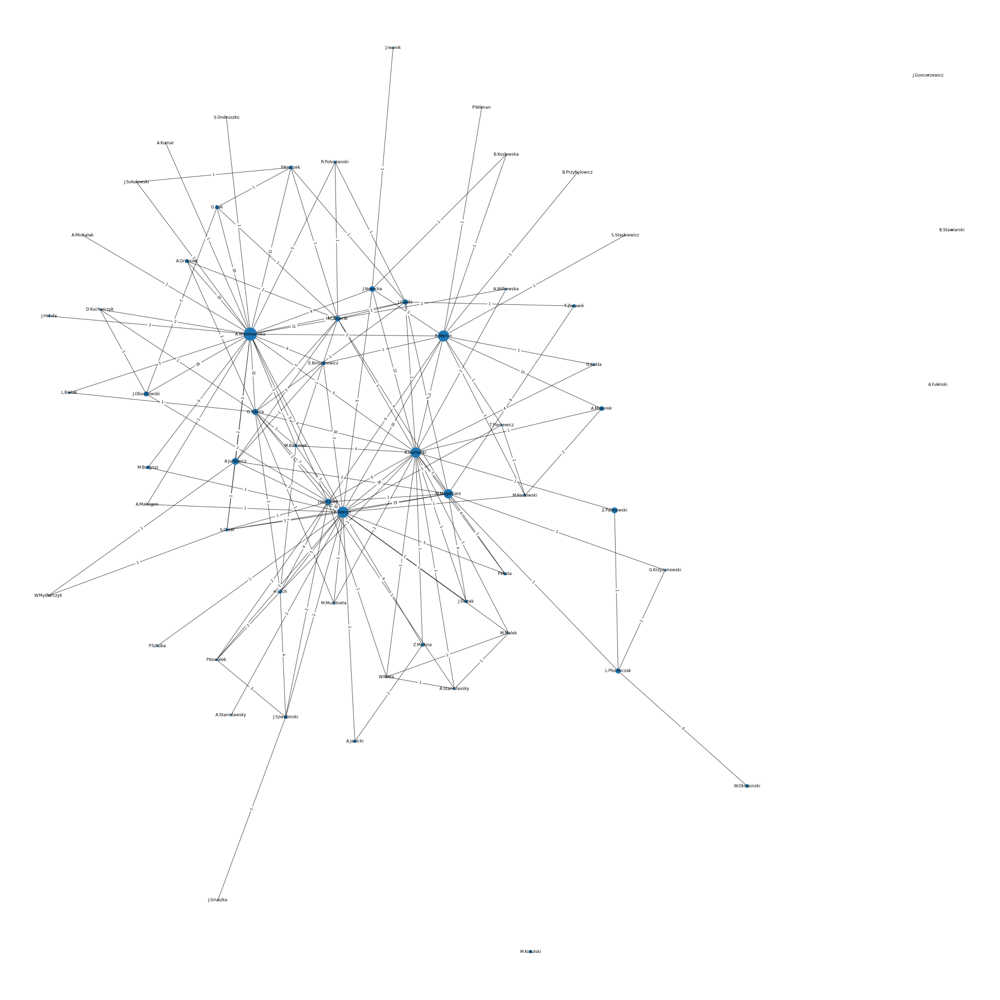

In [ ]:
img = mpimg.imread('graf.png') 
  
plt.figure(figsize=(40,40)) 
fig = plt.imshow(img) 

plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)

In [ ]:
max_value = max(d.values())
max_value

139

In [ ]:
keys = list(d.keys())
vals = list(d.values())
print(keys[vals.index(max_value)])

A.Wylomanska


Person with the biggest amount of papers is prof. Wyłomańska.

In [ ]:
max_value = max(dict(graf.degree).values())
keys = list(dict(graf.degree).keys())
vals = list(dict(graf.degree).values())
print(keys[vals.index(max_value)])

A.Wylomanska


Person with the biggest amount of collaborations is also prof. Wyłomańska.

I think the links between people are related to their common interests.

##Gif

In [ ]:
#saving figure for each year
nodes = [] 
edges = []
images = []
papers = soup.find_all('ol')   
for i in reversed(range(2,len(papers))):
  in_year = papers[i].find_all('li')
  for k in range(len(in_year)):
    one_paper = []
    for j in in_year[k].find_all("b"):
      nodes.append(clean_text(j.get_text()))
      one_paper.append(clean_text(j.get_text()))
    if one_paper != []:
      if len(one_paper)>=2:
        for j in range(len(one_paper )-1):
          for k in range(j+1,len(one_paper )):
            edges.append((one_paper[j],one_paper [k]))
  edges2 = []
  for (i,j) in edges:
    if (i,j) not in edges2 or (j,i) not in edges2:
      edges2.append((i,j,{'weight' : edges.count((i,j)) + edges.count((j,i))}))
  graf = nx.Graph()
  graf.add_nodes_from(nodes)
  graf.add_edges_from(edges2)
  d = {}
  for s in nodes:
    if s not in d.keys():
      d.update({s : nodes.count(s)})
  plt.figure(figsize=(30,30))
  nx.draw(graf, with_labels=True, pos= nx.nx_pydot.graphviz_layout(graf), node_size=[v * 10 for v in d.values()])
  edge_labels=dict([((u,v,),d['weight'])
  for u,v,d in graf.edges(data=True)])
  nx.draw_networkx_edge_labels(graf, pos= nx.nx_pydot.graphviz_layout(graf), edge_labels=edge_labels)
  plt.savefig("graf{i}.png".format(i=i))
  plt.close()
  images.append(imageio.imread("graf{i}.png".format(i=i)))
  
imageio.mimsave("gif.gif", images,  duration = 0.8) 
plt.close()

<Figure size 2160x2160 with 0 Axes>

{('K.Burnecki', 'A.Weron'): Text(89.5475, 23.319499999999998, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Weron', 'A.Wylomanska'): Text(142.505, 167.695, '1'),
 ('A.Weron', 'P.Mista'): Text(74.5735, 152.85, '1'),
 ('K.Burnecki', 'A.Weron'): Text(88.961, 119.3925, '2'),
 ('K.Burnecki', 'P.Mista'): Text(52.7345, 123.46249999999999, '1'),
 ('K.Burnecki', 'R.Weron'): Text(58.95, 54.0025, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Weron', 'A.Wylomanska'): Text(104.7555, 192.09500000000003, '1'),
 ('A.Weron', 'J.Nowicka'): Text(93.3115, 126.90350000000001, '1'),
 ('A.Weron', 'P.Mista'): Text(155.87, 150.21, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(80.2225, 262.62, '1'),
 ('K.Burnecki', 'A.Weron'): Text(130.515, 122.668, '3'),
 ('K.Burnecki', 'J.Nowicka'): Text(105.8665, 93.2415, '1'),
 ('K.Burnecki', 'P.Mista'): Text(168.425, 116.548, '1'),
 ('K.Burnecki', 'R.Weron'): Text(156.725, 53.503, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Weron', 'A.Wylomanska'): Text(125.8605, 132.51, '1'),
 ('A.Weron', 'J.Nowicka'): Text(165.04500000000002, 63.535, '1'),
 ('A.Weron', 'P.Mista'): Text(186.035, 98.6175, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(81.3575, 191.47, '1'),
 ('K.Burnecki', 'A.Weron'): Text(143.335, 81.5295, '3'),
 ('K.Burnecki', 'J.Nowicka'): Text(150.48000000000002, 35.9945, '1'),
 ('K.Burnecki', 'P.Mista'): Text(171.47, 71.077, '1'),
 ('K.Burnecki', 'R.Weron'): Text(93.01400000000001, 70.792, '2'),
 ('R.Weron', 'A.Wylomanska'): Text(75.5395, 121.7725, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Weron', 'A.Wylomanska'): Text(125.8605, 132.51, '1'),
 ('A.Weron', 'J.Nowicka'): Text(165.04500000000002, 63.535, '1'),
 ('A.Weron', 'P.Mista'): Text(186.035, 98.6175, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(81.3575, 191.47, '1'),
 ('K.Burnecki', 'A.Weron'): Text(143.335, 81.5295, '3'),
 ('K.Burnecki', 'J.Nowicka'): Text(150.48000000000002, 35.9945, '1'),
 ('K.Burnecki', 'P.Mista'): Text(171.47, 71.077, '1'),
 ('K.Burnecki', 'R.Weron'): Text(93.01400000000001, 70.792, '2'),
 ('R.Weron', 'A.Wylomanska'): Text(75.5395, 121.7725, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Weron', 'A.Wylomanska'): Text(141.685, 173.79500000000002, '1'),
 ('A.Weron', 'J.Nowicka'): Text(158.615, 108.855, '1'),
 ('A.Weron', 'P.Mista'): Text(208.715, 158.575, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(89.167, 226.46499999999997, '1'),
 ('K.Burnecki', 'A.Weron'): Text(189.47500000000002, 122.887, '3'),
 ('K.Burnecki', 'A.Wilkowska'): Text(217.895, 55.797, '1'),
 ('K.Burnecki', 'J.Nowicka'): Text(174.16000000000003, 79.562, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(241.135, 78.21549999999999, '1'),
 ('K.Burnecki', 'P.Mista'): Text(224.26, 129.28199999999998, '1'),
 ('K.Burnecki', 'R.Weron'): Text(160.565, 107.577, '2'),
 ('M.Teuerle', 'A.Wilkowska'): Text(254.01, 40.4185, '1'),
 ('R.Weron', 'A.Wylomanska'): Text(112.775, 158.485, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Weron', 'A.Janicki'): Text(212.45, 221.41000000000003, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(156.29500000000002, 211.32, '1'),
 ('A.Weron', 'J.Nowicka'): Text(164.085, 149.585, '1'),
 ('A.Weron', 'P.Mista'): Text(225.35500000000002, 176.0, '1'),
 ('A.Weron', 'R.Weron'): Text(160.92000000000002, 176.62, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(96.107, 261.465, '1'),
 ('K.Burnecki', 'A.Weron'): Text(196.79000000000002, 151.33, '3'),
 ('K.Burnecki', 'A.Wilkowska'): Text(202.82, 75.21000000000001, '1'),
 ('K.Burnecki',
  'J.Nowicka'): Text(171.60500000000002, 113.67500000000001, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(232.39000000000001, 87.718, '1'),
 ('K.Burnecki', 'P.Mista'): Text(232.875, 140.09, '1'),
 ('K.Burnecki', 'R.Weron'): Text(168.44, 140.71, '2'),
 ('M.Teuerle',
  'A.Wilkowska'): Text(230.90000000000003, 47.507999999999996, '1'),
 ('R.Weron', 'A.Wylomanska'): Text(127.945, 200.7, '1')}

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(236.13, 250.07, '1'),
 ('A.Weron', 'A.Janicki'): Text(238.13, 209.54500000000002, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(256.975, 183.59, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(174.63, 196.095, '1'),
 ('A.Weron', 'J.Nowicka'): Text(185.20999999999998, 143.42000000000002, '1'),
 ('A.Weron', 'P.Mista'): Text(243.79, 150.34, '1'),
 ('A.Weron', 'R.Weron'): Text(183.165, 164.65, '2'),
 ('A.Weron', 'Z.Michna'): Text(212.19, 216.775, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(101.982, 236.425, '1'),
 ('K.Burnecki', 'A.Weron'): Text(213.33499999999998, 135.792, '3'),
 ('K.Burnecki', 'A.Wilkowska'): Text(199.76999999999998, 56.667, '1'),
 ('K.Burnecki', 'J.Nowicka'): Text(184.355, 102.962, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(231.42000000000002, 60.2075, '1'),
 ('K.Burnecki', 'P.Mista'): Text(242.935, 109.882, '1'),
 ('K.Burnecki', 'R.Weron'): Text(182.31, 124.19200000000001, '2'),
 ('M.Teuerle', 'A.Wilkowska'): Text(218.71, 21.5405, '1'),
 ('R.Weron

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(236.13, 250.07, '1'),
 ('A.Weron', 'A.Janicki'): Text(238.13, 209.54500000000002, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(256.975, 183.59, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(174.63, 196.095, '1'),
 ('A.Weron', 'J.Nowicka'): Text(185.20999999999998, 143.42000000000002, '2'),
 ('A.Weron', 'P.Mista'): Text(243.79, 150.34, '1'),
 ('A.Weron', 'R.Weron'): Text(183.165, 164.65, '3'),
 ('A.Weron', 'Z.Michna'): Text(212.19, 216.775, '2'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(101.982, 236.425, '1'),
 ('K.Burnecki', 'A.Weron'): Text(213.33499999999998, 135.792, '4'),
 ('K.Burnecki', 'A.Wilkowska'): Text(199.76999999999998, 56.667, '1'),
 ('K.Burnecki', 'J.Nowicka'): Text(184.355, 102.962, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(231.42000000000002, 60.2075, '1'),
 ('K.Burnecki', 'P.Mista'): Text(242.935, 109.882, '1'),
 ('K.Burnecki', 'R.Weron'): Text(182.31, 124.19200000000001, '2'),
 ('M.Teuerle', 'A.Wilkowska'): Text(218.71, 21.5405, '1'),
 ('R.Weron

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(236.13, 250.07, '1'),
 ('A.Weron', 'A.Janicki'): Text(238.13, 209.54500000000002, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(256.975, 183.59, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(174.63, 196.095, '1'),
 ('A.Weron', 'J.Nowicka'): Text(185.20999999999998, 143.42000000000002, '2'),
 ('A.Weron', 'P.Mista'): Text(243.79, 150.34, '1'),
 ('A.Weron', 'R.Weron'): Text(183.165, 164.65, '3'),
 ('A.Weron', 'Z.Michna'): Text(212.19, 216.775, '2'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(101.982, 236.425, '1'),
 ('K.Burnecki', 'A.Weron'): Text(213.33499999999998, 135.792, '5'),
 ('K.Burnecki', 'A.Wilkowska'): Text(199.76999999999998, 56.667, '1'),
 ('K.Burnecki', 'J.Nowicka'): Text(184.355, 102.962, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(231.42000000000002, 60.2075, '1'),
 ('K.Burnecki', 'P.Mista'): Text(242.935, 109.882, '1'),
 ('K.Burnecki', 'R.Weron'): Text(182.31, 124.19200000000001, '2'),
 ('M.Teuerle', 'A.Wilkowska'): Text(218.71, 21.5405, '1'),
 ('R.Weron

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(238.435, 232.65, '1'),
 ('A.Weron', 'A.Janicki'): Text(237.495, 195.015, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(249.485, 166.115, '1'),
 ('A.Weron',
  'A.Wylomanska'): Text(167.73000000000002, 201.29500000000002, '1'),
 ('A.Weron', 'J.Nowicka'): Text(171.165, 150.02, '2'),
 ('A.Weron', 'P.Mista'): Text(226.68, 142.065, '1'),
 ('A.Weron', 'P.Sztuba'): Text(228.385, 214.32, '1'),
 ('A.Weron', 'R.Weron'): Text(171.51, 169.635, '5'),
 ('A.Weron', 'Z.Michna'): Text(206.35, 213.195, '2'),
 ('E.Broszkiewicz',
  'A.Wylomanska'): Text(99.47200000000001, 251.59500000000003, '1'),
 ('K.Burnecki', 'A.Weron'): Text(194.865, 135.65550000000002, '5'),
 ('K.Burnecki', 'A.Wilkowska'): Text(162.57999999999998, 61.3235, '1'),
 ('K.Burnecki', 'J.Nowicka'): Text(160.62, 110.1155, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(194.04500000000002, 56.8755, '1'),
 ('K.Burnecki', 'P.Mista'): Text(216.135, 102.1605, '1'),
 ('K.Burnecki', 'R.Weron'): Text(160.965, 129.7305, '2'),
 ('M

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(53.317, 121.422, '1'),
 ('A.Weron', 'A.Janicki'): Text(88.69500000000001, 101.747, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(97.483, 78.062, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(125.035, 146.07999999999998, '1'),
 ('A.Weron', 'J.Nowicka'): Text(153.28, 69.017, '2'),
 ('A.Weron', 'P.Mista'): Text(151.01, 84.951, '1'),
 ('A.Weron', 'P.Sztuba'): Text(117.11500000000001, 61.815, '1'),
 ('A.Weron', 'R.Weron'): Text(159.655, 137.14, '10'),
 ('A.Weron', 'Z.Michna'): Text(94.89200000000001, 125.30499999999999, '2'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(94.34700000000001, 220.115, '1'),
 ('K.Burnecki', 'A.Weron'): Text(173.91000000000003, 100.89099999999999, '5'),
 ('K.Burnecki', 'A.Wilkowska'): Text(243.23000000000002, 61.0475, '1'),
 ('K.Burnecki', 'G.Kukla'): Text(239.965, 124.561, '1'),
 ('K.Burnecki', 'J.Nowicka'): Text(196.92000000000002, 64.278, '1'),
 ('K.Burnecki', 'M.Teuerle'): Text(257.53499999999997, 85.3555, '1'),
 ('K.Burnecki', 'P.Mista'): 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(122.97, 99.5935, '1'),
 ('A.Weron', 'A.Janicki'): Text(166.065, 102.14349999999999, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(185.455, 87.8765, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(175.74, 158.32, '1'),
 ('A.Weron', 'J.Nowicka'): Text(210.09500000000003, 150.16, '4'),
 ('A.Weron', 'P.Mista'): Text(231.04000000000002, 102.847, '1'),
 ('A.Weron', 'P.Sztuba'): Text(209.47000000000003, 84.245, '1'),
 ('A.Weron', 'R.Weron'): Text(217.49, 171.465, '10'),
 ('A.Weron', 'Z.Michna'): Text(156.51500000000001, 123.94, '2'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(110.382, 204.97500000000002, '1'),
 ('J.Nowicka', 'B.Kozlowska'): Text(197.53500000000003, 209.21, '1'),
 ('K.Burnecki', 'A.Weron'): Text(239.38, 135.71, '6'),
 ('K.Burnecki', 'A.Wilkowska'): Text(311.125, 116.4065, '1'),
 ('K.Burnecki', 'G.Kukla'): Text(295.79499999999996, 173.18, '2'),
 ('K.Burnecki', 'J.Nowicka'): Text(249.865, 159.38, '8'),
 ('K.Burnecki', 'M.Teuerle'): Text(322.255, 141.1000000000

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(197.64, 50.69, '1'),
 ('A.Weron', 'A.Janicki'): Text(182.32, 78.09100000000001, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(162.03, 98.6645, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(178.695, 138.13, '2'),
 ('A.Weron', 'J.Nowicka'): Text(212.66, 133.46, '4'),
 ('A.Weron', 'P.Mista'): Text(239.915, 82.6305, '1'),
 ('A.Weron', 'P.Sztuba'): Text(198.45499999999998, 63.445, '1'),
 ('A.Weron', 'R.Weron'): Text(220.56, 153.82, '10'),
 ('A.Weron', 'Z.Michna'): Text(219.88, 81.489, '2'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(110.86200000000001, 178.035, '1'),
 ('J.Nowicka', 'B.Kozlowska'): Text(196.33999999999997, 191.64, '1'),
 ('K.Burnecki', 'A.Weron'): Text(242.17, 116.175, '6'),
 ('K.Burnecki', 'A.Wilkowska'): Text(314.78499999999997, 97.8545, '1'),
 ('K.Burnecki', 'G.Kukla'): Text(295.43499999999995, 152.45499999999998, '2'),
 ('K.Burnecki', 'J.Nowicka'): Text(250.26999999999998, 140.745, '8'),
 ('K.Burnecki', 'M.Teuerle'): Text(323.30999999999995, 122.91, 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(176.03, 48.7455, '1'),
 ('A.Weron', 'A.Janicki'): Text(164.59, 78.8725, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(148.60500000000002, 98.32, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(166.31, 144.55, '2'),
 ('A.Weron', 'J.Nowicka'): Text(206.64499999999998, 128.21, '4'),
 ('A.Weron', 'P.Mista'): Text(218.64, 75.952, '1'),
 ('A.Weron', 'P.Sztuba'): Text(178.13, 63.525, '1'),
 ('A.Weron', 'R.Weron'): Text(213.245, 148.06, '10'),
 ('A.Weron', 'Z.Michna'): Text(200.28, 78.923, '2'),
 ('A.Wylomanska', 'M.Borgosz'): Text(101.5635, 169.375, '2'),
 ('A.Wylomanska', 'S.Ondruszko'): Text(125.375, 220.535, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(106.337, 198.185, '1'),
 ('J.Nowicka', 'B.Kozlowska'): Text(210.69, 187.5, '1'),
 ('K.Burnecki', 'A.Weron'): Text(228.865, 106.72, '8'),
 ('K.Burnecki', 'A.Wilkowska'): Text(297.66499999999996, 72.007, '1'),
 ('K.Burnecki', 'G.Kukla'): Text(288.595, 129.62, '4'),
 ('K.Burnecki', 'J.Nowicka'): Text(246.67, 125.88, '9'),

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(182.91500000000002, 41.963499999999996, '1'),
 ('A.Weron', 'A.Janicki'): Text(168.78, 73.814, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(149.865, 86.9315, '1'),
 ('A.Weron', 'A.Makagon'): Text(148.29, 113.205, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(163.915, 143.675, '4'),
 ('A.Weron', 'J.Nowicka'): Text(223.92000000000002, 125.55000000000001, '5'),
 ('A.Weron', 'M.Kozlowski'): Text(200.6, 125.59, '1'),
 ('A.Weron', 'P.Mista'): Text(219.56, 74.2345, '1'),
 ('A.Weron', 'P.Sztuba'): Text(181.135, 62.165, '1'),
 ('A.Weron', 'R.Weron'): Text(210.215, 148.81, '10'),
 ('A.Weron', 'T.Piesiewicz'): Text(181.09, 136.49, '1'),
 ('A.Weron', 'Z.Michna'): Text(203.29500000000002, 74.4795, '2'),
 ('A.Wylomanska', 'A.Makagon'): Text(123.04499999999999, 150.55, '1'),
 ('A.Wylomanska', 'M.Borgosz'): Text(95.6575, 183.22, '3'),
 ('A.Wylomanska', 'S.Ondruszko'): Text(108.815, 212.60500000000002, '1'),
 ('E.Broszkiewicz', 'A.Wylomanska'): Text(152.21499999999997, 211.025, '3

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(195.525, 102.2995, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(90.832, 73.97999999999999, '1'),
 ('A.Weron', 'A.Janicki'): Text(174.76999999999998, 129.5495, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(150.64499999999998, 136.06, '1'),
 ('A.Weron', 'A.Makagon'): Text(144.64999999999998, 163.475, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(164.32, 191.79, '4'),
 ('A.Weron', 'E.Broszkiewicz'): Text(172.78, 210.565, '1'),
 ('A.Weron', 'J.Nowicka'): Text(179.445, 197.265, '5'),
 ('A.Weron', 'M.Kozlowski'): Text(225.03499999999997, 184.975, '1'),
 ('A.Weron', 'P.Mista'): Text(221.79000000000002, 141.87, '4'),
 ('A.Weron', 'P.Sztuba'): Text(191.77499999999998, 120.68199999999999, '1'),
 ('A.Weron', 'R.Weron'): Text(204.23, 211.735, '10'),
 ('A.Weron', 'T.Piesiewicz'): Text(199.92000000000002, 186.45, '1'),
 ('A.Weron', 'Z.Michna'): Text(205.735, 138.91, '3'),
 ('A.Wylomanska', 'A.Makagon'): Text(123.99, 189.105, '1'),
 ('A.Wylomanska', 'J.Nowicka'): Text(158.785, 22

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(196.39, 73.7045, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(88.6475, 47.0485, '1'),
 ('A.Weron', 'A.Janicki'): Text(175.245, 101.49549999999999, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(150.79500000000002, 107.2235, '1'),
 ('A.Weron', 'A.Makagon'): Text(140.312, 146.755, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(171.53, 159.88, '5'),
 ('A.Weron',
  'E.Broszkiewicz'): Text(169.10500000000002, 180.45499999999998, '2'),
 ('A.Weron', 'J.Nowicka'): Text(182.77, 177.575, '5'),
 ('A.Weron', 'M.Borgosz'): Text(147.235, 132.195, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(221.89000000000001, 157.51999999999998, '1'),
 ('A.Weron', 'P.Mista'): Text(220.865, 113.1455, '4'),
 ('A.Weron', 'P.Sztuba'): Text(190.91500000000002, 92.91149999999999, '1'),
 ('A.Weron', 'R.Weron'): Text(207.67000000000002, 182.995, '10'),
 ('A.Weron', 'T.Piesiewicz'): Text(197.375, 159.84, '1'),
 ('A.Weron', 'Z.Michna'): Text(205.885, 110.559, '3'),
 ('A.Wylomanska', 'A.Makagon'): Text(127.102, 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(189.52999999999997, 62.684, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(102.276, 68.507, '1'),
 ('A.Weron', 'A.Janicki'): Text(155.14, 88.5325, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(118.37599999999999, 102.7, '1'),
 ('A.Weron', 'A.Makagon'): Text(111.13749999999999, 138.41, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(142.0, 152.195, '5'),
 ('A.Weron', 'E.Broszkiewicz'): Text(139.42499999999998, 171.78, '2'),
 ('A.Weron', 'J.Nowicka'): Text(153.195, 169.72500000000002, '5'),
 ('A.Weron', 'M.Borgosz'): Text(116.234, 124.475, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(194.45, 150.54500000000002, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(139.54, 96.45700000000001, '5'),
 ('A.Weron', 'P.Mista'): Text(175.565, 107.089, '5'),
 ('A.Weron', 'P.Sztuba'): Text(170.63, 84.325, '1'),
 ('A.Weron', 'R.Weron'): Text(177.52499999999998, 175.84, '10'),
 ('A.Weron', 'T.Piesiewicz'): Text(169.815, 151.82, '1'),
 ('A.Weron', 'Z.Michna'): Text(190.02999999999997, 104.8015, '4'),
 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(167.82999999999998, 22.8275, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(208.075, 43.4955, '1'),
 ('A.Weron', 'A.Janicki'): Text(168.28, 59.565, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(194.16500000000002, 82.0625, '1'),
 ('A.Weron', 'A.Makagon'): Text(148.64, 95.36449999999999, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(172.64499999999998, 112.925, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(190.18, 123.09, '2'),
 ('A.Weron', 'J.Janczura'): Text(228.655, 78.1035, '2'),
 ('A.Weron', 'J.Nowicka'): Text(176.755, 137.05, '5'),
 ('A.Weron', 'M.Borgosz'): Text(155.3, 80.481, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(220.85, 131.2, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(209.16, 62.562999999999995, '9'),
 ('A.Weron', 'P.Mista'): Text(227.16, 65.9515, '5'),
 ('A.Weron', 'P.Sztuba'): Text(243.615, 101.28, '1'),
 ('A.Weron', 'R.Weron'): Text(209.07999999999998, 146.26999999999998, '10'),
 ('A.Weron', 'T.Piesiewicz'): Text(188.01999999999998, 143.39, '1'),
 ('A.Weron',

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(170.5, 40.409, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(194.515, 76.99000000000001, '1'),
 ('A.Weron', 'A.Janicki'): Text(164.12, 79.83500000000001, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(177.875, 98.81450000000001, '1'),
 ('A.Weron', 'A.Makagon'): Text(140.8785, 119.735, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(169.47, 133.275, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(169.005, 148.095, '2'),
 ('A.Weron', 'J.Janczura'): Text(200.415, 139.115, '2'),
 ('A.Weron', 'J.Nowicka'): Text(176.20999999999998, 161.645, '5'),
 ('A.Weron', 'M.Borgosz'): Text(147.015, 103.3765, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(221.7, 149.855, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(204.56, 100.8455, '12'),
 ('A.Weron', 'P.Mista'): Text(214.20999999999998, 84.337, '5'),
 ('A.Weron', 'P.Sztuba'): Text(233.57999999999998, 103.334, '1'),
 ('A.Weron', 'R.Weron'): Text(207.555, 164.87, '10'),
 ('A.Weron', 'T.Piesiewicz'): Text(188.325, 166.825, '1'),
 ('A.Weron', 'Z.Michna'): 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(132.7265, 113.86, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(201.39, 123.71000000000001, '2'),
 ('A.Weron', 'A.Janicki'): Text(127.3015, 145.3, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(178.94, 161.35500000000002, '2'),
 ('A.Weron', 'A.Makagon'): Text(114.1035, 192.35, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(146.95999999999998, 196.475, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(167.825, 199.61, '2'),
 ('A.Weron', 'J.Janczura'): Text(174.515, 180.17000000000002, '2'),
 ('A.Weron', 'J.Nowicka'): Text(152.43, 218.73499999999999, '5'),
 ('A.Weron', 'M.Borgosz'): Text(114.70349999999999, 177.76, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(193.04, 199.72, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(177.14, 138.485, '14'),
 ('A.Weron', 'P.Mista'): Text(194.715, 145.81, '5'),
 ('A.Weron', 'P.Sztuba'): Text(138.51999999999998, 132.951, '1'),
 ('A.Weron', 'R.Weron'): Text(185.85500000000002, 217.54, '10'),
 ('A.Weron', 'S.Orzel'): Text(113.1885, 159.125, '1'),
 ('A.Wero

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(180.825, 44.182, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(213.78, 83.723, '2'),
 ('A.Weron', 'A.Janicki'): Text(161.375, 77.76400000000001, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(184.83499999999998, 96.76, '2'),
 ('A.Weron', 'A.Makagon'): Text(135.4105, 118.49000000000001, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(169.23000000000002, 131.985, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(159.625, 144.285, '2'),
 ('A.Weron', 'J.Janczura'): Text(196.84, 133.85000000000002, '2'),
 ('A.Weron', 'J.Nowicka'): Text(178.92000000000002, 159.03, '5'),
 ('A.Weron', 'M.Borgosz'): Text(139.9365, 102.409, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(205.18, 152.465, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(211.16500000000002, 107.363, '17'),
 ('A.Weron', 'P.Mista'): Text(218.8, 90.792, '5'),
 ('A.Weron', 'P.Sztuba'): Text(179.875, 69.2, '1'),
 ('A.Weron', 'R.Weron'): Text(197.91500000000002, 166.26999999999998, '10'),
 ('A.Weron', 'S.Orzel'): Text(164.74, 100.8355, '3'),
 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(175.17000000000002, 73.791, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(220.76, 99.564, '2'),
 ('A.Weron', 'A.Janicki'): Text(190.14, 107.86250000000001, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(199.03, 135.57, '2'),
 ('A.Weron', 'A.Makagon'): Text(152.31, 182.985, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(180.195, 166.985, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(189.035, 186.755, '2'),
 ('A.Weron', 'G.Sikora'): Text(167.78, 147.72, '2'),
 ('A.Weron', 'J.Janczura'): Text(220.45499999999998, 173.685, '3'),
 ('A.Weron', 'J.Nowicka'): Text(178.02499999999998, 196.2, '5'),
 ('A.Weron', 'M.Borgosz'): Text(148.885, 163.445, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(227.88, 202.995, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(219.3, 128.644, '18'),
 ('A.Weron', 'M.Muszkieta'): Text(166.38, 131.483, '1'),
 ('A.Weron', 'P.Mista'): Text(242.45, 139.66500000000002, '5'),
 ('A.Weron', 'P.Sztuba'): Text(253.855, 157.99, '1'),
 ('A.Weron', 'R.Weron'): Text(212.20999999999

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(314.68, 158.55, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(188.345, 124.84, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(145.715, 138.62, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(121.6865, 107.0625, '1'),
 ('A.Weron', 'A.Janicki'): Text(274.225, 186.135, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(190.23000000000002, 165.875, '2'),
 ('A.Weron', 'A.Makagon'): Text(177.805, 218.77499999999998, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(191.645, 194.375, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(198.335, 215.36, '2'),
 ('A.Weron', 'G.Sikora'): Text(212.395, 168.575, '2'),
 ('A.Weron', 'J.Janczura'): Text(208.36, 194.99, '3'),
 ('A.Weron', 'J.Nowicka'): Text(203.215, 229.07999999999998, '5'),
 ('A.Weron', 'M.Borgosz'): Text(170.305, 193.845, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(248.78000000000003, 231.07, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(220.575, 155.595, '18'),
 ('A.Weron', 'M.Muszkieta'): Text(241.79000000000002, 157.11, '1'),
 ('A.Weron', 'P.Mista')

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(305.57500000000005, 155.615, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(215.8, 106.33, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(166.665, 104.08500000000001, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(154.765, 66.1075, '1'),
 ('A.Weron', 'A.Janicki'): Text(257.63, 157.715, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(197.05, 145.83, '2'),
 ('A.Weron', 'A.Makagon'): Text(167.59, 195.125, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(187.10000000000002, 175.905, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(187.35000000000002, 198.39, '2'),
 ('A.Weron', 'G.Sikora'): Text(224.575, 161.85500000000002, '2'),
 ('A.Weron', 'J.Janczura'): Text(203.74, 182.505, '3'),
 ('A.Weron', 'J.Nowicka'): Text(188.26999999999998, 213.935, '5'),
 ('A.Weron', 'M.Borgosz'): Text(168.685, 164.95, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(232.16500000000002, 225.695, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(234.34, 147.49, '18'),
 ('A.Weron', 'M.Muszkieta'): Text(208.22500000000002, 160.4, '1'

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(318.14, 168.075, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(187.72, 118.53999999999999, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(146.07, 136.27499999999998, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(121.7175, 98.4545, '1'),
 ('A.Weron', 'A.Janicki'): Text(281.43, 185.235, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(193.60500000000002, 160.23000000000002, '2'),
 ('A.Weron', 'A.Makagon'): Text(185.39, 212.52, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(189.91500000000002, 187.765, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(202.26, 207.04500000000002, '2'),
 ('A.Weron', 'G.Sikora'): Text(222.515, 160.46, '4'),
 ('A.Weron', 'J.Janczura'): Text(210.725, 191.86, '4'),
 ('A.Weron', 'J.Nowicka'): Text(203.505, 221.29000000000002, '5'),
 ('A.Weron', 'J.Slezak'): Text(260.025, 148.85000000000002, '1'),
 ('A.Weron', 'M.Borgosz'): Text(201.88, 171.41000000000003, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(255.66000000000003, 225.45000000000002, '1'),
 ('A.Weron', 'M.Magdz

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(329.96500000000003, 192.465, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(192.015, 151.195, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(154.88, 194.125, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(116.52799999999999, 217.155, '1'),
 ('A.Weron', 'A.Janicki'): Text(289.315, 211.145, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(198.875, 189.60500000000002, '2'),
 ('A.Weron', 'A.Makagon'): Text(208.25, 240.925, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(196.85500000000002, 200.635, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(214.315, 229.505, '2'),
 ('A.Weron', 'G.Sikora'): Text(222.39, 176.76, '5'),
 ('A.Weron', 'H.Loch'): Text(249.065, 166.72, '2'),
 ('A.Weron', 'J.Janczura'): Text(219.35500000000002, 201.265, '6'),
 ('A.Weron', 'J.Nowicka'): Text(213.55, 214.775, '5'),
 ('A.Weron', 'J.Slezak'): Text(275.12, 173.885, '1'),
 ('A.Weron', 'M.Borgosz'): Text(195.11, 234.065, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(264.885, 247.7, '1'),
 ('A.Weron', 'M.Magdziarz'): Text(2

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(335.09000000000003, 163.04500000000002, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(190.55, 147.36, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(158.13, 193.67000000000002, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(118.893, 220.74, '1'),
 ('A.Weron', 'A.Janicki'): Text(294.085, 189.325, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(198.935, 184.97, '2'),
 ('A.Weron', 'A.Makagon'): Text(208.56, 219.16500000000002, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(202.54000000000002, 175.84, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(218.585, 213.255, '2'),
 ('A.Weron', 'G.Sikora'): Text(236.245, 160.945, '6'),
 ('A.Weron', 'H.Loch'): Text(266.115, 173.91500000000002, '2'),
 ('A.Weron', 'J.Janczura'): Text(223.85000000000002, 183.535, '6'),
 ('A.Weron', 'J.Nowicka'): Text(220.17000000000002, 193.595, '5'),
 ('A.Weron', 'J.Slezak'): Text(275.08, 148.32999999999998, '1'),
 ('A.Weron', 'M.Balcerek'): Text(228.75, 146.28, '2'),
 ('A.Weron', 'M.Borgosz'): Text(196.78, 211.935,

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(333.065, 196.29500000000002, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(202.70499999999998, 173.0, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(162.5, 210.075, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(115.552, 214.29, '1'),
 ('A.Weron', 'A.Janicki'): Text(295.275, 225.81, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(207.465, 211.5, '2'),
 ('A.Weron', 'A.Makagon'): Text(213.845, 258.625, '1'),
 ('A.Weron',
  'A.Wylomanska'): Text(220.95999999999998, 214.57999999999998, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(231.115, 250.48000000000002, '2'),
 ('A.Weron', 'G.Sikora'): Text(221.49, 228.04000000000002, '6'),
 ('A.Weron', 'H.Loch'): Text(224.595, 274.415, '2'),
 ('A.Weron', 'J.Janczura'): Text(233.615, 235.465, '6'),
 ('A.Weron', 'J.Nowicka'): Text(271.225, 223.595, '5'),
 ('A.Weron', 'J.Slezak'): Text(278.555, 190.465, '1'),
 ('A.Weron', 'M.Balcerek'): Text(239.575, 200.67000000000002, '2'),
 ('A.Weron', 'M.Borgosz'): Text(206.79000000000002, 250.45, '1'),
 

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(155.09, 226.03, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(273.855, 270.08, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(286.88, 286.59000000000003, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(318.58, 257.875, '1'),
 ('A.Weron', 'A.Janicki'): Text(164.79000000000002, 266.455, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(238.13, 296.365, '2'),
 ('A.Weron', 'A.Makagon'): Text(213.16500000000002, 347.33, '1'),
 ('A.Weron', 'A.Wylomanska'): Text(235.485, 329.15, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(206.365, 329.985, '2'),
 ('A.Weron', 'G.Sikora'): Text(223.375, 327.44, '7'),
 ('A.Weron', 'H.Loch'): Text(184.29500000000002, 333.97, '3'),
 ('A.Weron', 'J.Janczura'): Text(220.57, 311.205, '8'),
 ('A.Weron', 'J.Nowicka'): Text(186.755, 310.90999999999997, '5'),
 ('A.Weron', 'J.Slezak'): Text(207.445, 256.86, '1'),
 ('A.Weron', 'M.Balcerek'): Text(211.4, 317.2, '3'),
 ('A.Weron', 'M.Borgosz'): Text(201.825, 348.57, '1'),
 ('A.Weron', 'M.Kozlowski'): Text(156.53, 2

<Figure size 2160x2160 with 0 Axes>

{('A.Janicki', 'Z.Michna'): Text(155.285, 176.075, '1'),
 ('A.Jurlewicz', 'M.Magdziarz'): Text(290.44, 237.485, '2'),
 ('A.Jurlewicz', 'S.Orzel'): Text(290.05, 259.32500000000005, '1'),
 ('A.Jurlewicz', 'W.Mydlarczyk'): Text(341.21500000000003, 263.775, '1'),
 ('A.Stanislavsky', 'M.Malek'): Text(217.095, 138.20499999999998, '1'),
 ('A.Stanislavsky', 'W.Nitka'): Text(232.305, 144.66, '1'),
 ('A.Weron', 'A.Janicki'): Text(163.71, 218.56, '2'),
 ('A.Weron', 'A.Jurlewicz'): Text(244.565, 264.605, '2'),
 ('A.Weron', 'A.Makagon'): Text(204.885, 299.665, '1'),
 ('A.Weron', 'A.Stanislawsky'): Text(162.0, 277.105, '2'),
 ('A.Weron', 'A.Wylomanska'): Text(231.32, 287.635, '6'),
 ('A.Weron', 'E.Broszkiewicz'): Text(209.66500000000002, 287.165, '2'),
 ('A.Weron', 'G.Sikora'): Text(226.59500000000003, 272.56, '7'),
 ('A.Weron', 'H.Loch'): Text(193.135, 243.56, '5'),
 ('A.Weron', 'J.Janczura'): Text(214.72000000000003, 248.585, '10'),
 ('A.Weron', 'J.Nowicka'): Text(194.705, 279.375, '5'),
 ('A.Wero

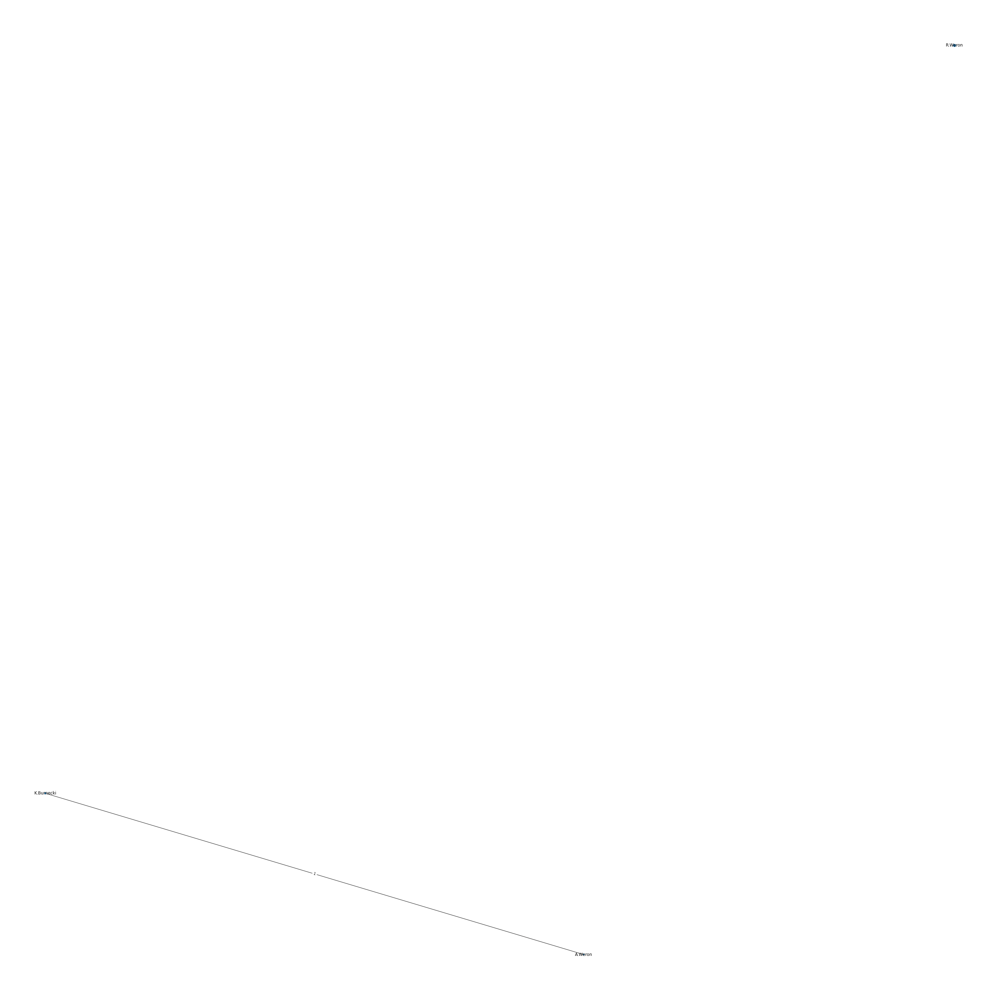

In [ ]:
gifPath = Path("gif.gif")
with open(gifPath,'rb') as f:
    display.Image(data=f.read(), format='png')